In [1]:
workspace_dir = './data'

from torch.utils.data import Dataset, DataLoader
import cv2
import os

class FaceDataset(Dataset):
    def __init__(self, fnames, transform):
        self.transform = transform
        self.fnames = fnames
        self.num_samples = len(self.fnames)
    def __getitem__(self,idx):
        fname = self.fnames[idx]
        img = cv2.imread(fname)
        img = self.BGR2RGB(img) #because "torchvision.utils.save_image" use RGB
        img = self.transform(img)
        return img

    def __len__(self):
        return self.num_samples

    def BGR2RGB(self,img):
        return cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

import glob
import torchvision.transforms as transforms

def get_dataset(root):
    fnames = glob.glob(os.path.join(root, '*'))
    # resize the image to (64, 64)
    # linearly map [0, 1] to [-1, 1]
    transform = transforms.Compose(
        [transforms.ToPILImage(),
         transforms.Resize((64, 64)),
         transforms.ToTensor(),
         transforms.Normalize(mean=[0.5] * 3, std=[0.5] * 3) ] )
    dataset = FaceDataset(fnames, transform)
    return dataset

提供random seed的函数，以便reproduce

In [2]:
import random
import torch
import numpy as np

def same_seeds(seed):
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)  # if use multi-GPU
    np.random.seed(seed)  # Numpy module
    random.seed(seed)  # Python random module
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True

### Model
使用DCGAN网络

<img src="DCGAN.png" width="80%">
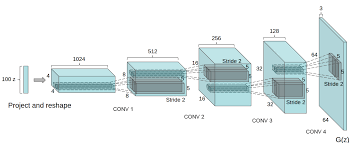

In [3]:
import torch.nn as nn
import torch.functional as F

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

class Generator(nn.Module):
    """
    input: (n_batch, in_dim)
    output: (n_batch, 3, 64, 64)
    """
    def __init__(self, in_dim, dim=64):
        super(Generator, self).__init__()
        self.layer1 = nn.Sequential(
            nn.Linear(in_dim, dim * 8 * 4 * 4, bias=False),
            nn.BatchNorm1d(dim * 8 * 4 * 4),
            nn.ReLU())
        self.layer2 = self.deconv_bn_relu(dim*8, dim*4)
        self.layer3 = self.deconv_bn_relu(dim*4, dim*2)
        self.layer4 = self.deconv_bn_relu(dim*2, dim)
        self.layer5 = nn.Sequential(
                        nn.ConvTranspose2d(dim, 3, kernel_size=5, stride=2,
                               padding=2, output_padding=1, bias=False),
                        nn.Tanh())
        self.apply(weights_init)
        
    def forward(self, x):
        x = self.layer1(x)
        x = x.view(x.size(0), -1, 4, 4)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        output = self.layer5(x)
        
        return output
        
    def deconv_bn_relu(self, in_dim, out_dim):
        return nn.Sequential(
            nn.ConvTranspose2d(in_dim, out_dim, kernel_size=5, stride=2,
                               padding=2, output_padding=1, bias=False),
            nn.BatchNorm2d(out_dim),
            nn.ReLU())
    
class Discriminator(nn.Module):
    """
    input: (n_batch, 3, 64, 64)
    output: (n_batch, )
    """
    def __init__(self, in_dim, dim=64):
        super(Discriminator, self).__init__()
        self.layer1 = nn.Sequential(
            nn.Conv2d(in_dim, dim, 5, 2, 2),
            nn.LeakyReLU(0.2))
        self.layer2 = self.conv_bn_lrrelu(dim, dim*2)
        self.layer3 = self.conv_bn_lrrelu(dim*2, dim*4)
        self.layer4 = self.conv_bn_lrrelu(dim*4, dim*8)
        self.layer5 = nn.Sequential(
            nn.Conv2d(dim * 8, 1, 4),
            nn.Sigmoid())
        self.apply(weights_init)
        
    def forward(self, x):
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.layer5(x)
        output = x.view(-1)
        
        return output
        
    def conv_bn_lrrelu(self, in_dim, out_dim):
        return nn.Sequential(
            nn.Conv2d(in_dim, out_dim, 5, 2, 2),
            nn.BatchNorm2d(out_dim),
            nn.LeakyReLU(0.2))

In [118]:
import torch
from torch import optim
from torch.autograd import Variable
import torchvision
from torchsummary import summary

n_GPU = torch.cuda.device_count()
# hyperparameters 
batch_size = 128*n_GPU
z_dim = 100
lr = 4e-4
n_epoch = 30
save_dir = os.path.join(workspace_dir, 'logs')
os.makedirs(save_dir, exist_ok=True)

# model
G = Generator(in_dim=z_dim).cuda()
D = Discriminator(3).cuda()
# summary(G, (1, 100))
# summary(D, (3, 64, 64))
if torch.cuda.device_count() > 1:
    print("Let's use", torch.cuda.device_count(), "GPUs!")
    # dim = 0 [30, xxx] -> [10, ...], [10, ...], [10, ...] on 3 GPUs
    G = nn.DataParallel(G)
    D = nn.DataParallel(D)
    
G.train()
D.train()


# loss criterion
criterion = nn.BCELoss()  # 二分类交叉熵

# optimizer
opt_D = torch.optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
opt_G = torch.optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))


same_seeds(0)
# dataloader (You might need to edit the dataset path if you use extra dataset.)
dataset = get_dataset(os.path.join(workspace_dir, 'faces'))
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=4)

Let's use 2 GPUs!


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


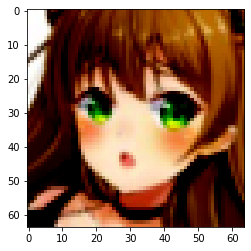

In [120]:
# 隨便印一張圖看看
import matplotlib.pyplot as plt
plt.imshow(dataset[10].numpy().transpose(1,2,0))

Epoch [1/30] 279/279 Loss_D: 0.4082 Loss_G: 4.50593 Time: 1m0s

Save some samples to ./data/logs/Epoch_001.jpg.


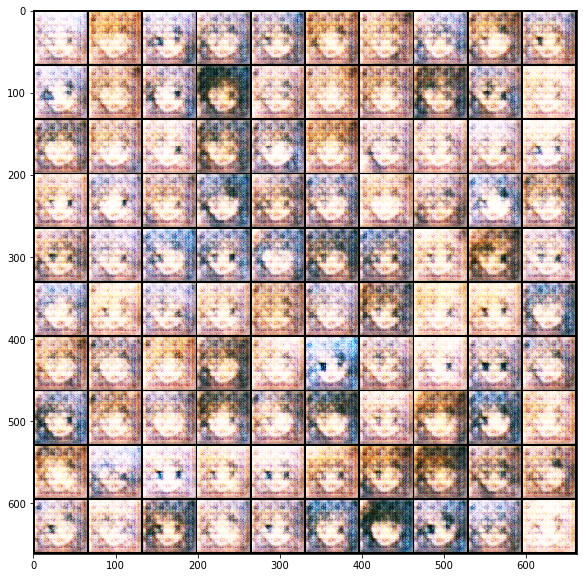

Epoch [2/30] 279/279 Loss_D: 0.9366 Loss_G: 7.51696 Time: 1m1s

Save some samples to ./data/logs/Epoch_002.jpg.


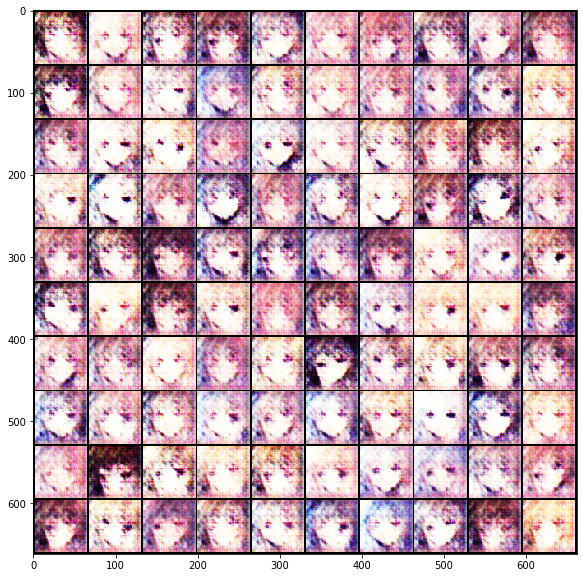

Epoch [3/30] 279/279 Loss_D: 0.3660 Loss_G: 3.1149 Time: 1m5s

Save some samples to ./data/logs/Epoch_003.jpg.


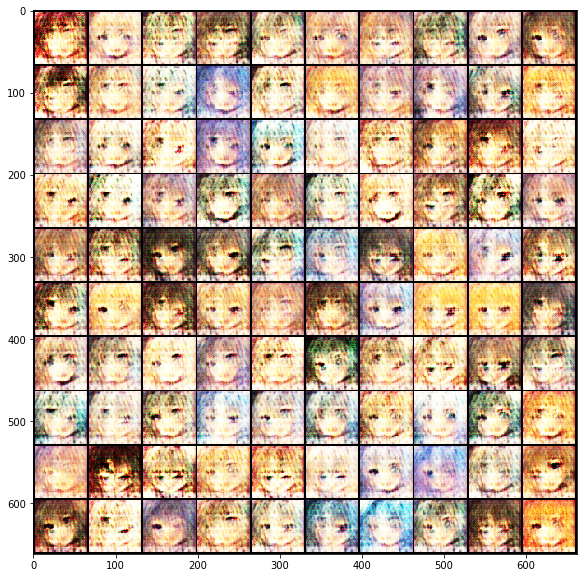

Epoch [4/30] 279/279 Loss_D: 0.4443 Loss_G: 2.22008 Time: 1m7s

Save some samples to ./data/logs/Epoch_004.jpg.


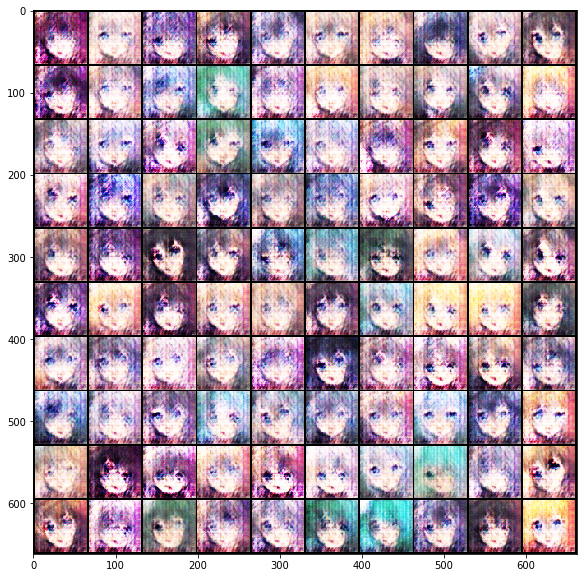

Epoch [5/30] 279/279 Loss_D: 0.7901 Loss_G: 2.2374 Time: 1m7s

Save some samples to ./data/logs/Epoch_005.jpg.


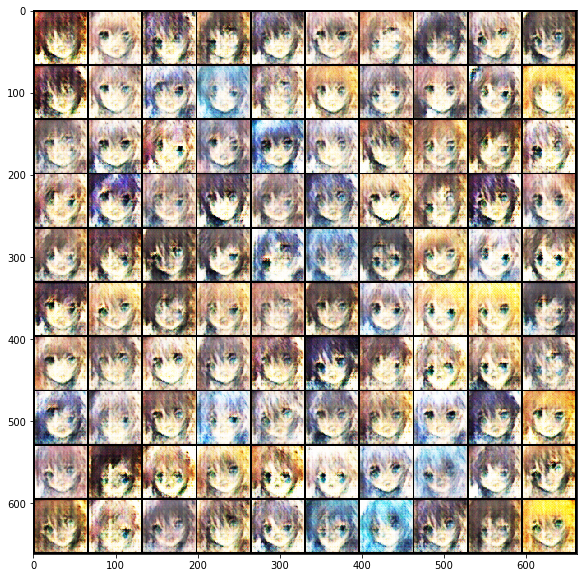

Epoch [6/30] 279/279 Loss_D: 0.5196 Loss_G: 4.2778 Time: 1m8s

Save some samples to ./data/logs/Epoch_006.jpg.


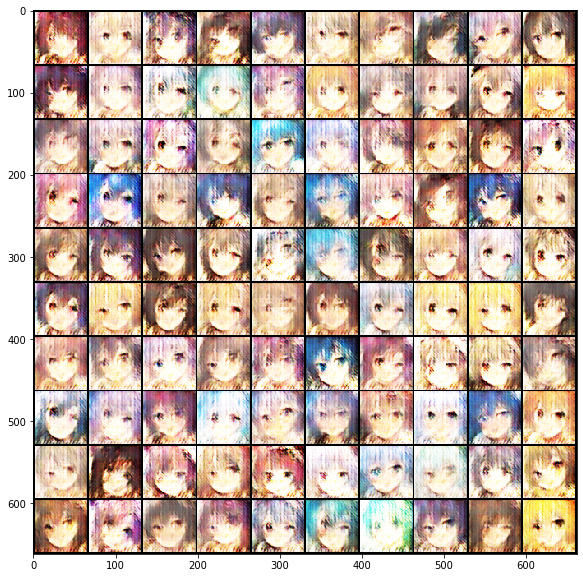

Epoch [7/30] 279/279 Loss_D: 0.4532 Loss_G: 2.2003 Time: 1m8s

Save some samples to ./data/logs/Epoch_007.jpg.


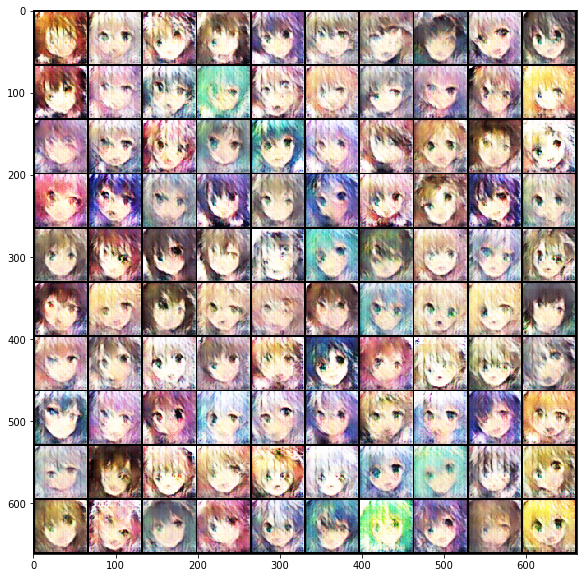

Epoch [8/30] 279/279 Loss_D: 0.4731 Loss_G: 3.6596 Time: 1m8s

Save some samples to ./data/logs/Epoch_008.jpg.


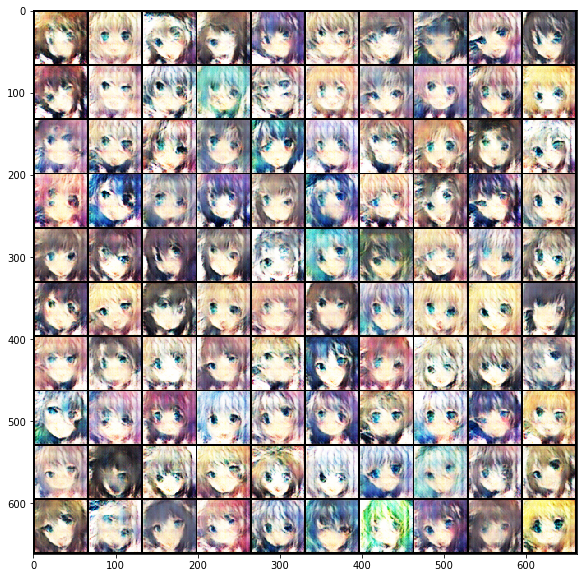

Epoch [9/30] 279/279 Loss_D: 0.5677 Loss_G: 4.5269 Time: 1m8s

Save some samples to ./data/logs/Epoch_009.jpg.


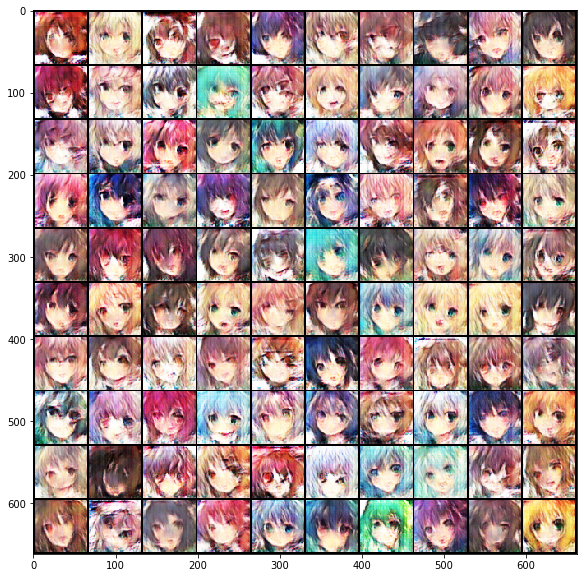

Epoch [10/30] 279/279 Loss_D: 0.3899 Loss_G: 3.7444 Time: 1m7s

Save some samples to ./data/logs/Epoch_010.jpg.


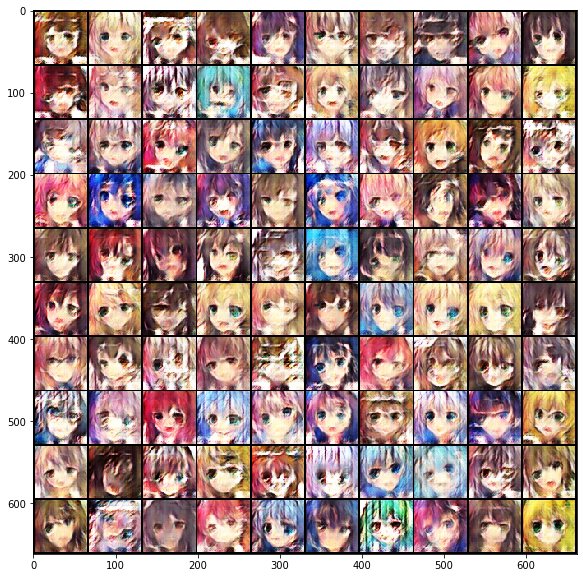

Epoch [11/30] 279/279 Loss_D: 0.4547 Loss_G: 3.6556 Time: 1m7s

Save some samples to ./data/logs/Epoch_011.jpg.


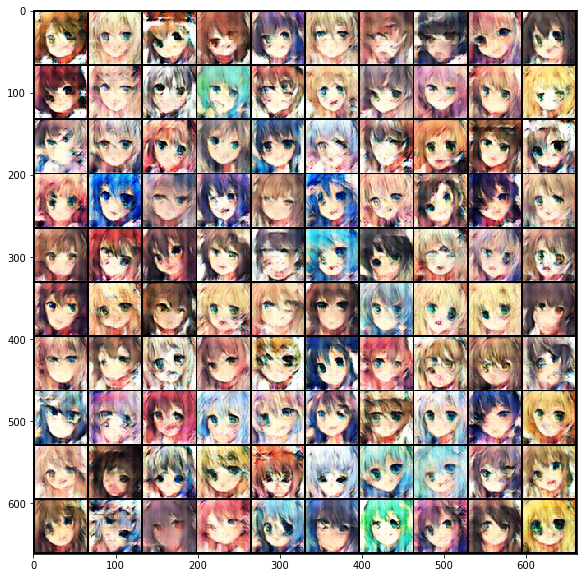

Epoch [12/30] 279/279 Loss_D: 0.7379 Loss_G: 1.8255 Time: 1m8s

Save some samples to ./data/logs/Epoch_012.jpg.


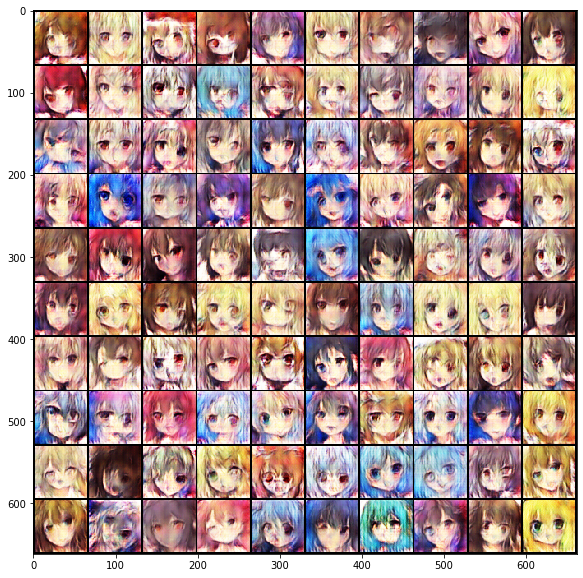

Epoch [13/30] 279/279 Loss_D: 0.3357 Loss_G: 3.1431 Time: 1m8s

Save some samples to ./data/logs/Epoch_013.jpg.


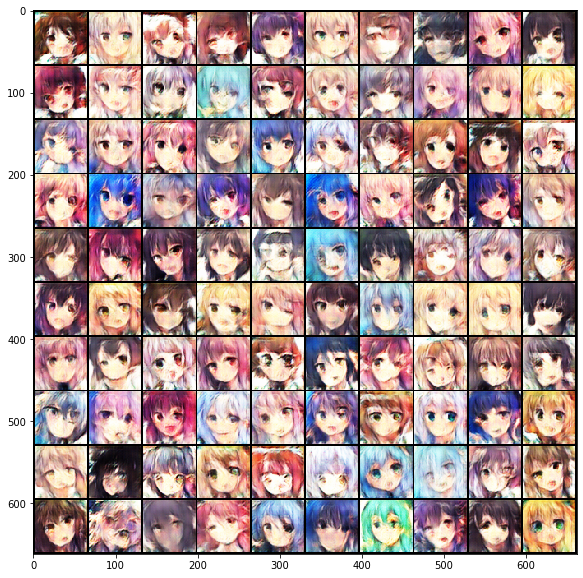

Epoch [14/30] 279/279 Loss_D: 0.3067 Loss_G: 2.6614 Time: 1m8s

Save some samples to ./data/logs/Epoch_014.jpg.


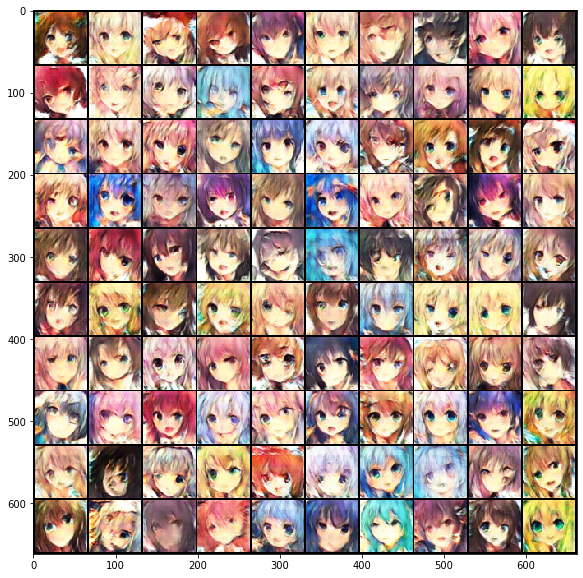

Epoch [15/30] 279/279 Loss_D: 0.3485 Loss_G: 3.0983 Time: 1m8s

Save some samples to ./data/logs/Epoch_015.jpg.


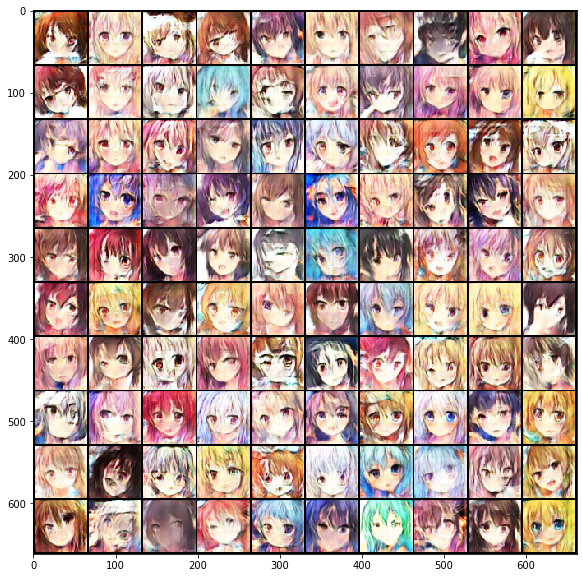

Epoch [16/30] 279/279 Loss_D: 0.4091 Loss_G: 2.5478 Time: 1m8s

Save some samples to ./data/logs/Epoch_016.jpg.


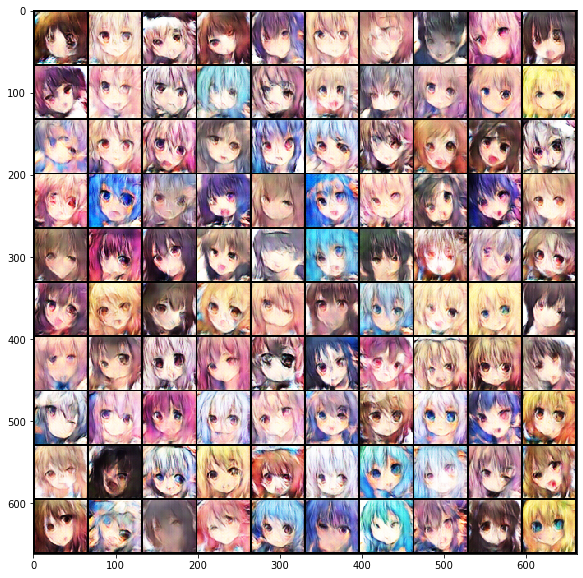

Epoch [17/30] 279/279 Loss_D: 0.3056 Loss_G: 2.7284 Time: 1m8s

Save some samples to ./data/logs/Epoch_017.jpg.


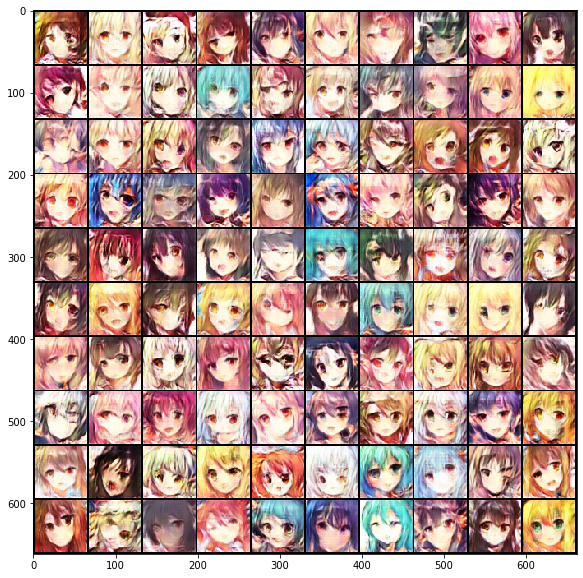

Epoch [18/30] 279/279 Loss_D: 0.3516 Loss_G: 2.2067 Time: 1m8s

Save some samples to ./data/logs/Epoch_018.jpg.


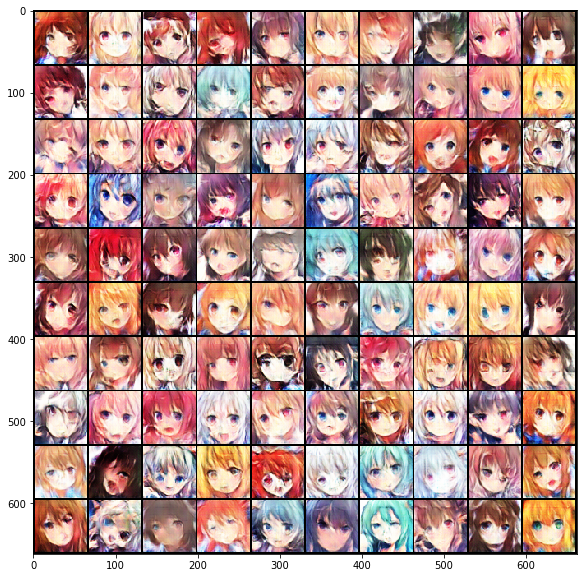

Epoch [19/30] 279/279 Loss_D: 0.3663 Loss_G: 2.5360 Time: 1m8s

Save some samples to ./data/logs/Epoch_019.jpg.


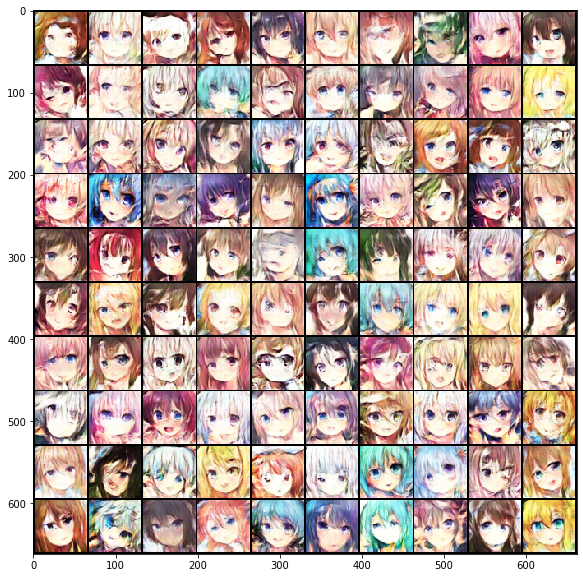

Epoch [20/30] 279/279 Loss_D: 0.4123 Loss_G: 4.9819 Time: 1m8s

Save some samples to ./data/logs/Epoch_020.jpg.


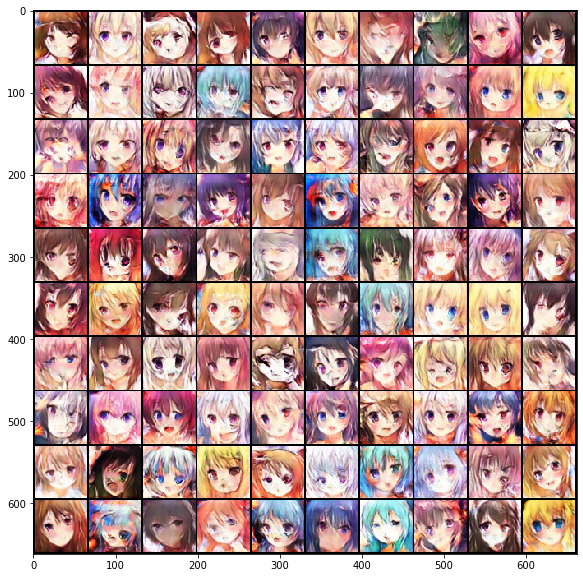

Epoch [21/30] 279/279 Loss_D: 0.4600 Loss_G: 4.5277 Time: 1m8s

Save some samples to ./data/logs/Epoch_021.jpg.


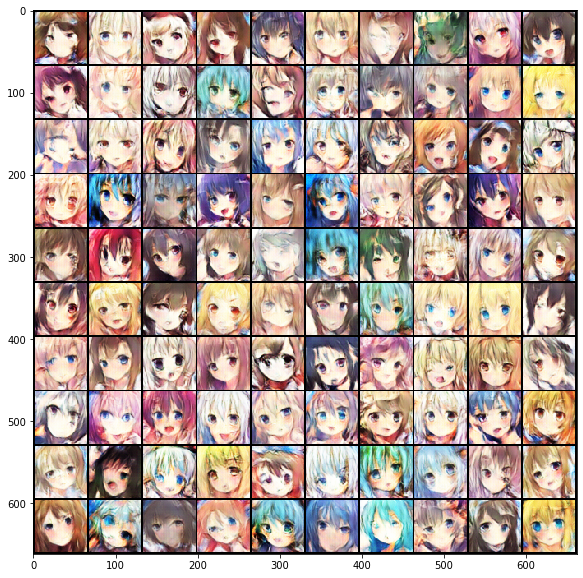

Epoch [22/30] 279/279 Loss_D: 0.2858 Loss_G: 1.8529 Time: 1m8s

Save some samples to ./data/logs/Epoch_022.jpg.


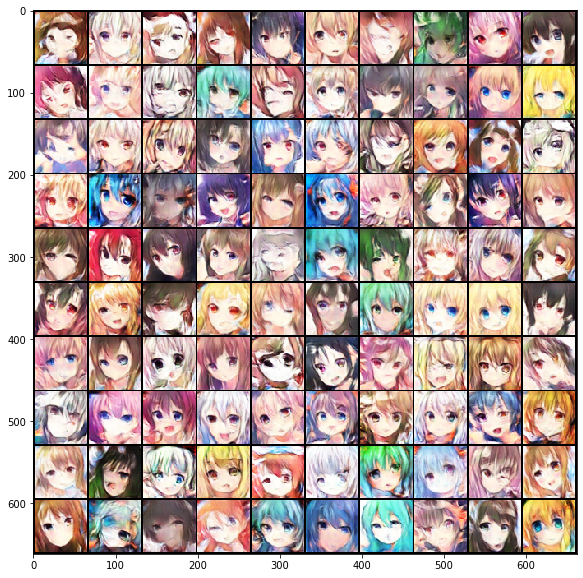

Epoch [23/30] 279/279 Loss_D: 0.4058 Loss_G: 4.4328 Time: 1m8s

Save some samples to ./data/logs/Epoch_023.jpg.


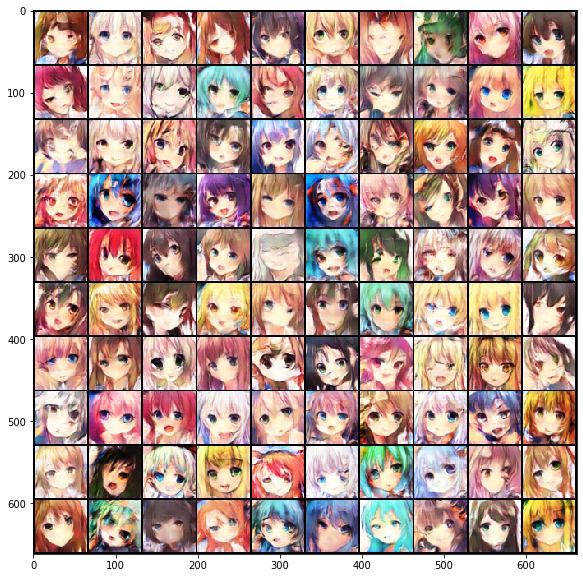

Epoch [24/30] 279/279 Loss_D: 4.4946 Loss_G: 4.6265 Time: 1m8s

Save some samples to ./data/logs/Epoch_024.jpg.


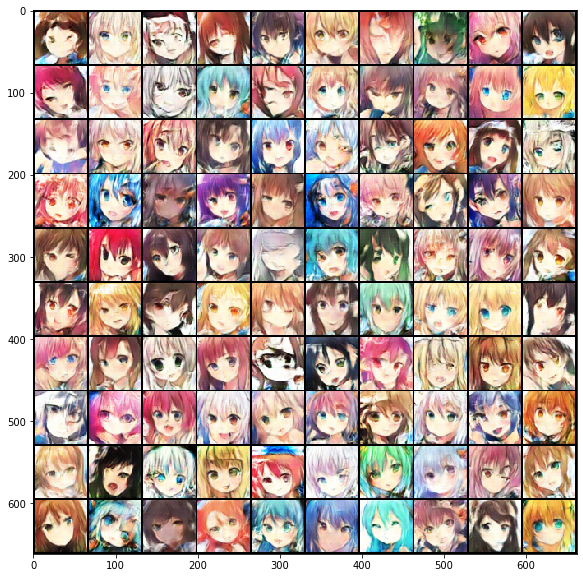

Epoch [25/30] 279/279 Loss_D: 0.2350 Loss_G: 2.9259 Time: 1m8s

Save some samples to ./data/logs/Epoch_025.jpg.


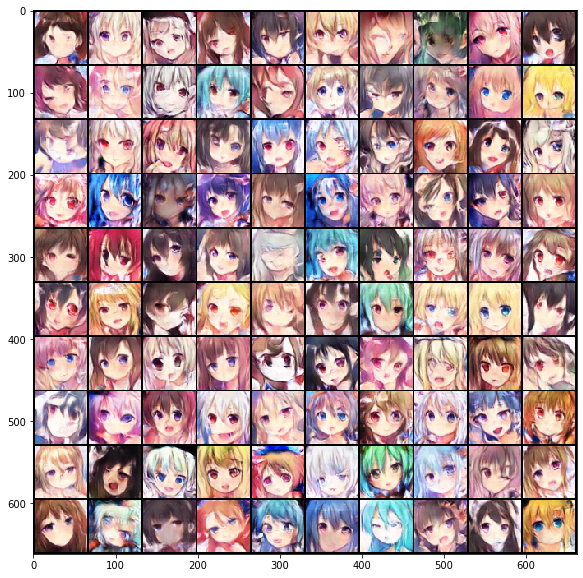

Epoch [26/30] 279/279 Loss_D: 0.4658 Loss_G: 4.3134 Time: 1m8s

Save some samples to ./data/logs/Epoch_026.jpg.


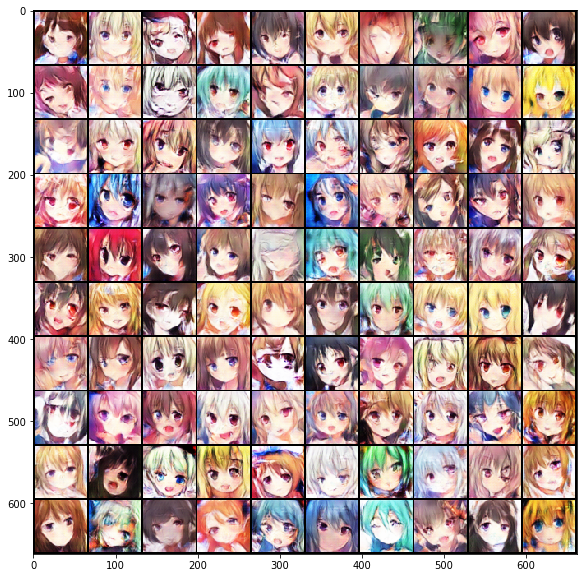

Epoch [27/30] 279/279 Loss_D: 0.2655 Loss_G: 2.3004 Time: 1m8s

Save some samples to ./data/logs/Epoch_027.jpg.


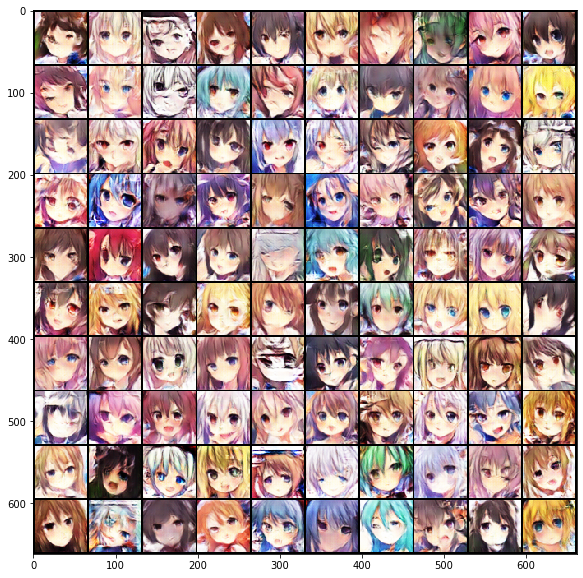

Epoch [28/30] 279/279 Loss_D: 0.1873 Loss_G: 4.0717 Time: 1m8s

Save some samples to ./data/logs/Epoch_028.jpg.


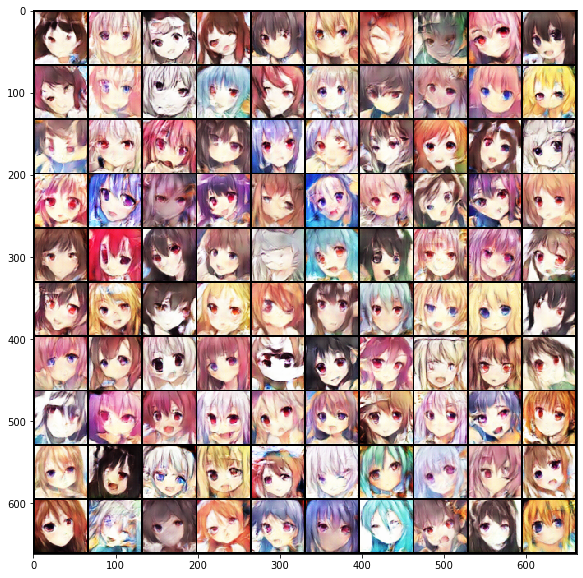

Epoch [29/30] 279/279 Loss_D: 0.5127 Loss_G: 4.6393 Time: 1m8s

Save some samples to ./data/logs/Epoch_029.jpg.


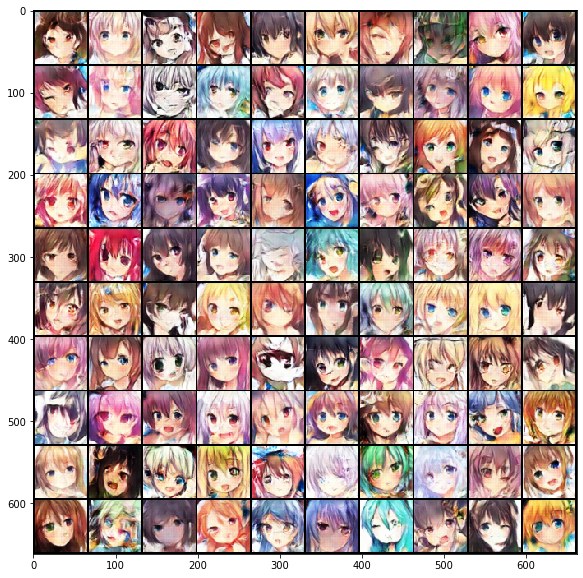

Epoch [30/30] 279/279 Loss_D: 0.2264 Loss_G: 4.0697 Time: 1m8s

Save some samples to ./data/logs/Epoch_030.jpg.


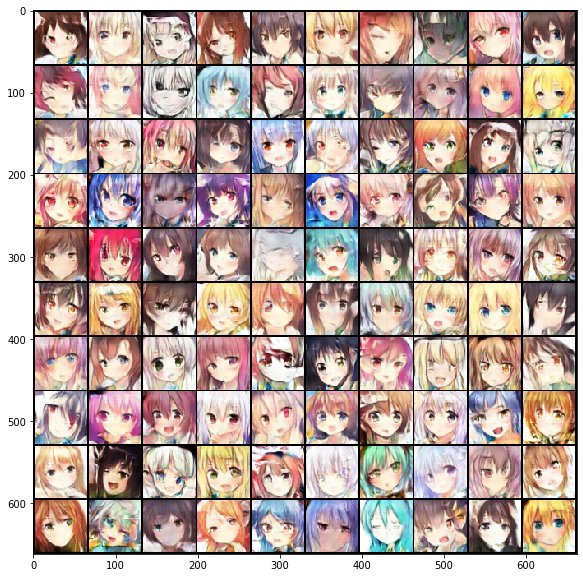


Total training time: 0h34m10s


In [122]:
import time
import datetime

begin = datetime.datetime.now()
# for logging
z_sample = Variable(torch.randn(100, z_dim)).cuda()
for e, epoch in enumerate(range(n_epoch)):
    start = datetime.datetime.now()
    for i, data in enumerate(dataloader):
        imgs = data
        imgs = imgs.cuda()
        
        bs = imgs.size(0)
        
        """ Train D """
        z = Variable(torch.randn(bs, z_dim)).cuda()
        r_imgs = Variable(imgs).cuda()
        f_imgs = G(z)
        
        # Label
        r_label = torch.ones((bs)).cuda()
        f_label = torch.zeros((bs)).cuda()
        
        # Dis
        r_logit = D(r_imgs.detach())  # 切断梯度传播
        f_logit = D(f_imgs.detach())
        
        # Compute loss
        r_loss = criterion(r_logit, r_label)
#         print(f'r_logit = {r_logit}, r_loss = {r_loss}\n')
        f_loss = criterion(f_logit, f_label)
        loss_D = (r_loss + f_loss) / 2
        
        # Update model
        D.zero_grad()
        loss_D.backward()
        opt_D.step()
        
        """ Traing G """
        # Leaf
        z = Variable(torch.randn(bs, z_dim)).cuda()
        f_imgs = G(z)
        
        # Dis
        f_logit = D(f_imgs)
        
        # Compute loss
        loss_G = criterion(f_logit, r_label)
        
        # Update model
        G.zero_grad()
        loss_G.backward()
        opt_G.step()
        
        # Log
        print(f'\rEpoch [{epoch+1}/{n_epoch}] {i+1}/{len(dataloader)} Loss_D: {loss_D.item():.4f} Loss_G: {loss_G.item():.4f}', end='')
    end = datetime.datetime.now()
    seconds = (end - start).seconds
    print(" Time: {}m{}s".format(seconds//60, seconds%60))
    G.eval()
    f_imgs_sample = (G(z_sample).data + 1) / 2.0
    filename = os.path.join(save_dir, f'Epoch_{epoch+1:03d}.jpg')
    torchvision.utils.save_image(f_imgs_sample, filename, nrow=10)
    print(f'\nSave some samples to {filename}.')
    # Show generated image
    grid_img = torchvision.utils.make_grid(f_imgs_sample.cpu(), nrow=10)
    plt.figure(figsize=(10, 10))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.show()
    G.train()
    if (e+1) % 5 == 0:
        torch.save(G.state_dict(), os.path.join(workspace_dir, f'dcgan_g.pth'))
        torch.save(G.state_dict(), os.path.join(workspace_dir, f'dcgan_d.pth'))
finish = datetime.datetime.now()
all_seconds = (finish - begin).seconds
print("\nTotal training time: {}h{}m{}s".format(all_seconds//3600, all_seconds//60, all_seconds%60))

In [ ]:
import torch

# Load pretrained model
G = Generator(z_dim).cuda()
if torch.cuda.device_count() > 1:
    print("Let's use", torch.cuda.device_count(), "GPUs!")
    # dim = 0 [30, xxx] -> [10, ...], [10, ...], [10, ...] on 3 GPUs
    G = nn.DataParallel(G)
G.load_state_dict(torch.load(os.path.join(workspace_dir, 'dcgan_g.pth')))
G.eval()

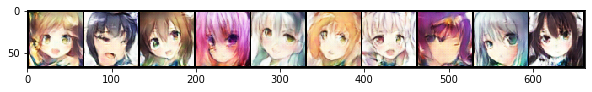

In [149]:
# Generate images and save the result
n_output = 10
z_sample = Variable(torch.randn(n_output, z_dim)).cuda()
imgs_sample = (G(z_sample).data + 1) / 2.0  # denorm
save_dir = os.path.join(workspace_dir, 'logs')
filename = os.path.join(save_dir, f'result.jpg')
torchvision.utils.save_image(imgs_sample, filename, nrow=10)
# Show image
grid_img = torchvision.utils.make_grid(imgs_sample.cpu(), nrow=10)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()